In [1]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

import os
os.chdir(r"C:\Users\kaborg15\Python_projects\Vibrent_Style_Quiz_Generation")

import pandas as pd
from resources.constants import *
from src import load_dataframes

outfits_df = load_dataframes.load_pickle(DATA_SAVE_PATH, OUTFITS_PATH)
pictures_df = pd.read_csv(PICTURE_TRIPLETS_CSV_PATH, sep=CSV_SEPARATOR)
user_triplets_df = pd.read_csv(USER_ACTIVITY_TRIPLETS_CSV_PATH, sep=CSV_SEPARATOR)

outfit_id_to_outfit_group_dict = outfits_df.groupby("id").first().reset_index().set_index("id")[["group"]].to_dict()["group"]
# For the purposes of this notebook, we're not interested in duplicate outfits
outfits_df = outfits_df.groupby("group").first().reset_index()

In [2]:
import numpy as np

def get_outfit_category(tag_categories, tags, category):
    tag_categories, tags = np.array(tag_categories), np.array(tags)
    category_indexes = np.where(tag_categories == category)[0]
    if len(category_indexes) == 0:
        return []
    cat_tags = tags[category_indexes]
    return cat_tags

outfits_df["category"] = outfits_df.apply(lambda x: get_outfit_category(x["tag_categories"], x["outfit_tags"], "Category"), axis=1)
outfit_category_dict = outfits_df[["id", "category"]].set_index("id").to_dict()["category"]

In [3]:
user_rentals_df = user_triplets_df.groupby("customer.id").agg({"outfit.id": list, "meta.validFrom": list, "derived.bookingTime": list,}).reset_index()
def get_outfit_categories(outfit_ids, outfits_to_categories):
    return [category for outfit_id in outfit_ids for category in outfits_to_categories.get(outfit_id, [])]

user_rentals_df["outfit_categories"] = user_rentals_df["outfit.id"].apply(lambda x: get_outfit_categories(x, outfit_category_dict))
user_rentals_df["num_rentals"] = user_rentals_df["outfit.id"].apply(len)

In [4]:
import pickle

# Load pre-computed embeddings from pickle to outfits_df

PICKLED_DICT_PATH = r"resources\data\dataset\embeddings\EfficientNet_V2_L_final_dict.pkl"
with open(PICKLED_DICT_PATH, "rb") as f:
    embeddings_dict = pickle.load(f)

pictures_df["embedding"] = pictures_df["picture.id"].apply(lambda x: embeddings_dict[x])
# Sort displayorder beforehand to ensure embeddings are in the correct order
pictures_dict = pictures_df.sort_values("displayOrder").groupby("outfit.id").agg({"embedding": list, "displayOrder":list, "picture.id": list}).to_dict()
outfits_to_embeddings_dict = pictures_dict["embedding"]
outfits_to_pictures_id_dict = pictures_dict["picture.id"]
outfits_df["embeddings"] = outfits_df["id"].apply(lambda x: outfits_to_embeddings_dict.get(x, []))
outfits_df["picture_ids"] = outfits_df["id"].apply(lambda x: outfits_to_pictures_id_dict.get(x, []))
outfits_df["num_pictures"] = outfits_df["embeddings"].apply(len)
# Use the first picture as the a representative embedding for the outfit
example_embedding = outfits_df["embeddings"].iloc[0][0]
dummy_embedding = np.zeros_like(example_embedding)
outfits_df["lead_embedding"] = outfits_df["embeddings"].apply(lambda x: x[0] if len(x) > 0 else dummy_embedding)
outfits_df["lead_picture_id"] = outfits_df["picture_ids"].apply(lambda x: x[0] if len(x) > 0 else None)
print(f"{len(outfits_df[outfits_df['num_pictures'] == 0])} of {len(outfits_df)} outfits have no embeddings")

330 of 9791 outfits have no embeddings


In [5]:
from tqdm.notebook import tqdm

#Find positive examples for each outfit group for triplet loss
user_rentals_df["group"] = user_rentals_df["outfit.id"].apply(lambda x: [outfit_id_to_outfit_group_dict[outfit_id] for outfit_id in x])

outfit_positive_examples_dict = {outfit_id: [] for outfit_id in outfits_df["group"]}
for user_rentals in tqdm(user_rentals_df["group"]):
    for outfit_id in user_rentals:
        user_rentals_without_outfit = [x for x in user_rentals if x != outfit_id]
        outfit_positive_examples_dict[outfit_id].extend(user_rentals_without_outfit)

# Record number of positive examples per outfit, will be useful for debugging and analysis later on
outfits_df["num_positive_examples"] = outfits_df["group"].apply(lambda x: len(outfit_positive_examples_dict[x]))

  0%|          | 0/2249 [00:00<?, ?it/s]

In [6]:
from sklearn.preprocessing import MultiLabelBinarizer

# Filter out tags from undesirable categories and those that are too infrequent
EXCLUDED_TAG_CATEGORIES = ["Category", "brand", "Size"]

def get_outfit_tags(tag_categories, tags, excluded_categories):
    tag_categories, tags = np.array(tag_categories), np.array(tags)
    excluded_indexes = np.where(np.isin(tag_categories, excluded_categories))[0]
    if len(excluded_indexes) == 0:
        return tags, tag_categories
    excluded_tags = np.delete(tags, excluded_indexes)
    excluded_tag_categories = np.delete(tag_categories, excluded_indexes)
    return excluded_tags, excluded_tag_categories

outfits_df[["filtered_tags", "filtered_categories"]] = pd.DataFrame(outfits_df.apply(
    lambda x: get_outfit_tags(x["tag_categories"], x["outfit_tags"], EXCLUDED_TAG_CATEGORIES), 
    axis=1
).tolist(), index=outfits_df.index)

def filter_tags_by_frequency(tag_categories, tags, accepted_tags):
    tag_categories, tags = np.array(tag_categories), np.array(tags)
    included_indexes = np.where(np.isin(tags, accepted_tags))[0]
    return tags[included_indexes], tag_categories[included_indexes]


tag_value_counts = outfits_df["filtered_tags"].explode().value_counts()
tag_value_counts = tag_value_counts[tag_value_counts > 20]

outfits_df[["filtered_tags", "filtered_categories"]] = pd.DataFrame(outfits_df.apply(
    lambda x: filter_tags_by_frequency(x["filtered_categories"], x["filtered_tags"], tag_value_counts.index), 
    axis=1
).tolist(), index=outfits_df.index)

In [7]:

all_tags = outfits_df["filtered_tags"].values.tolist()
mlb = MultiLabelBinarizer()
one_hot_encoded = mlb.fit_transform(all_tags)
outfits_df["one_hot_encoded"] = [np.array(oh_list) for oh_list in one_hot_encoded.tolist()]

In [8]:
import torch
import torch.nn as nn
import torch.optim as optim
import pandas as pd
import numpy as np

def get_mean_embedding(embeddings):
    embeddings = np.array(embeddings)
    mean_embedding = np.mean(embeddings, axis=0)
    return mean_embedding

def concatenate_embeddings(oh_embeddings, image_embeddings, oh_weighting):
    oh_embeddings = np.array(oh_embeddings) * oh_weighting
    return np.concatenate((oh_embeddings, image_embeddings))

#outfits_df["mean_embeddings"] = outfits_df["embeddings"].apply(lambda x: get_mean_embedding(x))
#one_hot_encoded = np.array(outfits_df["one_hot_encoded"].tolist())
#mean_embeddings = np.array(outfits_df["mean_embeddings"].tolist())

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#Combine one-hot encoded tags and image embeddings
EMBEDDINGS_COLUMN = "concatenated_embeddings"
outfits_df["concatenated_embeddings"] = outfits_df.apply(lambda x: concatenate_embeddings(x["one_hot_encoded"], x["lead_embedding"], oh_weighting=4), axis=1)
input_embeddings = outfits_df[EMBEDDINGS_COLUMN]#np.concatenate((one_hot_encoded, mean_embeddings), axis=1)
input_embeddings = torch.tensor(input_embeddings.tolist(), dtype=torch.float32).to(device)

# To make calculating the loss easier, we'll create a dictionary mapping outfit group to its embeddings and convert it to a tensor
outfit_group_embeddings_dict = outfits_df.set_index("group")[EMBEDDINGS_COLUMN].to_dict()
for key, value in outfit_group_embeddings_dict.items():
    outfit_group_embeddings_dict[key] = torch.tensor(value, dtype=torch.float32, requires_grad=True).to(device)

C:\Users\kaborg15\AppData\Local\Temp\ipykernel_18816\1423999862.py:26: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\torch\csrc\utils\tensor_new.cpp:277.)
  input_embeddings = torch.tensor(input_embeddings.tolist(), dtype=torch.float32).to(device)


In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from tqdm import tqdm
import numpy as np

class TripletEncoder(nn.Module):
    def __init__(self, input_dim, hidden_dim, latent_dim):
        super(TripletEncoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.LeakyReLU(),
            nn.Linear(hidden_dim, latent_dim),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.encoder(x)

def euclidean_distance(x1, x2):
    return (x1 - x2).pow(2).sum(dim=1).sqrt()

def find_triplet_loss_pairs(anchor_index, outfits_df, positive_examples_dict, embeddings_dict):
    anchor_group = outfits_df["group"].iloc[anchor_index]
    positive_options = positive_examples_dict[anchor_group]
    if len(positive_options) == 0:
        return None, None, None
    else:   
        positive_example = np.random.choice(positive_options)
    negative_examples = None
    while negative_examples is None or positive_example in negative_examples:
        negative_examples = np.random.choice(outfits_df["group"].values)

    anchor_embedding = embeddings_dict[anchor_group]
    positive_embedding = embeddings_dict[positive_example]
    negative_embedding = embeddings_dict[negative_examples]
    return anchor_embedding, positive_embedding, negative_embedding

# Hyperparameters
input_dim = input_embeddings.shape[1]
hidden_dim = 256
latent_dim = 128
num_epochs = 5
batch_size = 32
learning_rate = 0.001
margin = 0.1

# Instantiate the model, define the loss function and the optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = TripletEncoder(input_dim, hidden_dim, latent_dim).to(device)
triplet_loss = nn.TripletMarginLoss(margin=margin, p=2)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Training loop
for epoch in tqdm(range(num_epochs), desc="Epochs"):
    permutation = torch.randperm(len(outfits_df))
    total_loss = 0
    num_valid_triplets = 0

    for i in tqdm(range(0, len(outfits_df), batch_size), desc="Batches", leave=False):
        indices = permutation[i:i+batch_size]
        
        anchors, positives, negatives = [], [], []
        for idx in indices:
            anchor, positive, negative = find_triplet_loss_pairs(idx.item(), outfits_df, outfit_positive_examples_dict, outfit_group_embeddings_dict)
            if anchor is not None:
                anchors.append(anchor)
                positives.append(positive)
                negatives.append(negative)
        
        if not anchors:
            continue

        # Stack tensors
        anchors = torch.stack(anchors).to(device)
        positives = torch.stack(positives).to(device)
        negatives = torch.stack(negatives).to(device)
        
        anchor_encodings = model(anchors)
        positive_encodings = model(positives)
        negative_encodings = model(negatives)

        loss = triplet_loss(anchor_encodings, positive_encodings, negative_encodings)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()
        num_valid_triplets += len(anchors)

    avg_loss = total_loss / num_valid_triplets if num_valid_triplets > 0 else 0
    print(f"Epoch [{epoch+1}/{num_epochs}], Average Loss: {avg_loss:.4f}")

# Save the trained encoder
#torch.save(model.state_dict(), 'triplet_encoder_model.pth')

Epochs:  20%|██        | 1/5 [00:06<00:25,  6.35s/it]

Epoch [1/5], Average Loss: 0.0042


Epochs:  40%|████      | 2/5 [00:11<00:17,  5.90s/it]

Epoch [2/5], Average Loss: 0.0036


Epochs:  60%|██████    | 3/5 [00:17<00:11,  5.72s/it]

Epoch [3/5], Average Loss: 0.0034


Epochs:  80%|████████  | 4/5 [00:22<00:05,  5.61s/it]

Epoch [4/5], Average Loss: 0.0033


Epochs: 100%|██████████| 5/5 [00:28<00:00,  5.71s/it]


Epoch [5/5], Average Loss: 0.0032


In [10]:
import numpy as np
def get_outfit_embeddings(input_embeddings, model):
    with torch.no_grad():
        encoded = model(input_embeddings)
    return encoded

outfit_embeddings = get_outfit_embeddings(input_embeddings, model)
outfits_df["outfit_embeddings"] = [x.tolist() for x in outfit_embeddings]
print(np.stack(outfits_df["outfit_embeddings"].values).shape)

(9791, 128)


In [11]:
# Save the embeddings to file, so we can load them directly into the style quiz
OUTFIT_EMBEDDINGS_DF_PATH = r"resources\data\outfit_embeddings_triplets_df.pkl"
outfits_df.to_pickle(OUTFIT_EMBEDDINGS_DF_PATH)

No. of points: 9791


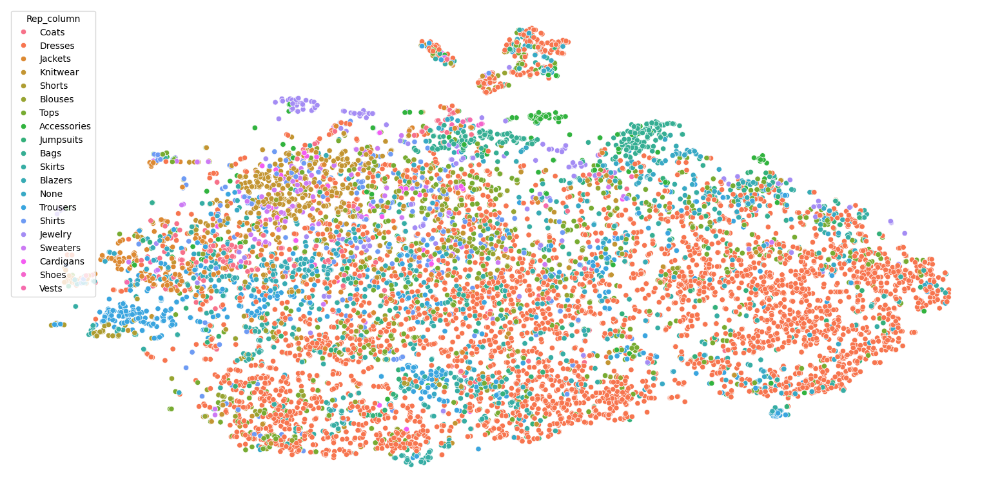

In [24]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import seaborn as sns
from src import generate_embedding_tsnes_with_thumbnails

FIGURE_SAVE_PATH = "reports/figures/outfit_tsne.png"

outfits_df["rep_column"] = outfits_df["category"].apply(lambda x: x[0] if len(x) > 0 else "None")

#Generate TSNE diagram of embeddings, but only for outfits with at least one picture
#Save this graph to file to load it into PIL for later editing
tsne_df, scatter_plot = generate_embedding_tsnes_with_thumbnails.generate_tsne_diagram(outfits_df, "outfit_embeddings", hue_column="rep_column", show_plot=True, save_path=FIGURE_SAVE_PATH)

No. of points: 9791


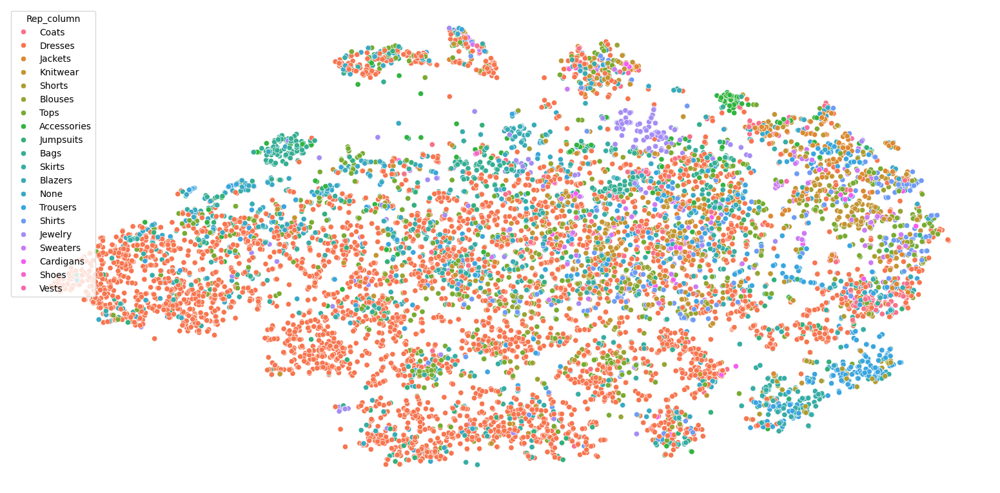

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import seaborn as sns
from src import generate_embedding_tsnes_with_thumbnails

FIGURE_SAVE_PATH = "reports/figures/outfit_tsne.png"

outfits_df["rep_column"] = outfits_df["category"].apply(lambda x: x[0] if len(x) > 0 else "None")

#Generate TSNE diagram of embeddings, but only for outfits with at least one picture
#Save this graph to file to load it into PIL for later editing
tsne_df, scatter_plot = generate_embedding_tsnes_with_thumbnails.generate_tsne_diagram(outfits_df, "outfit_embeddings", hue_column="rep_column", show_plot=True, save_path=FIGURE_SAVE_PATH)

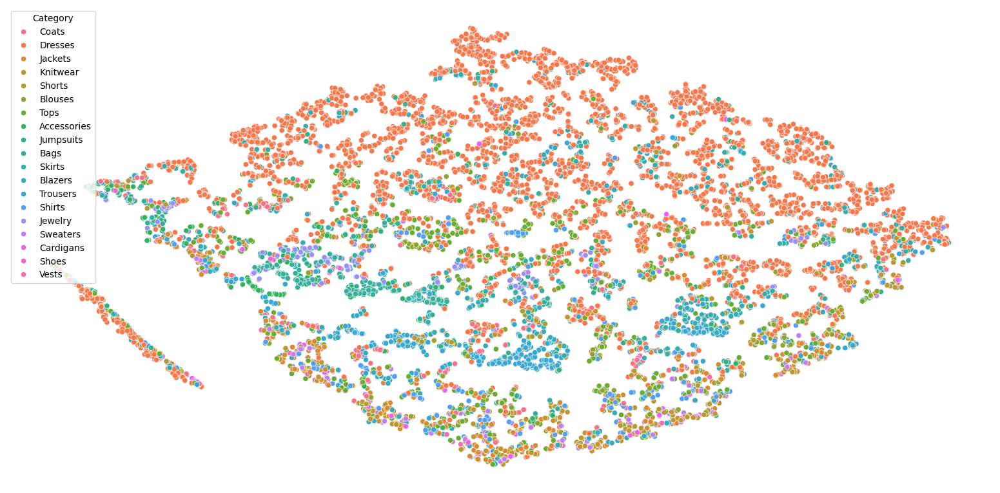

In [23]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import seaborn as sns
from src import generate_embedding_tsnes_with_thumbnails

FIGURE_SAVE_PATH = "reports/figures/outfit_tsne.png"

#Generate TSNE diagram of embeddings, but only for outfits with at least one picture
#Save this graph to file to load it into PIL for later editing
tsne_df, scatter_plot = generate_embedding_tsnes_with_thumbnails.generate_tsne_diagram(outfits_df, "outfit_embeddings", show_plot=True, save_path=FIGURE_SAVE_PATH)

0it [00:00, ?it/s]

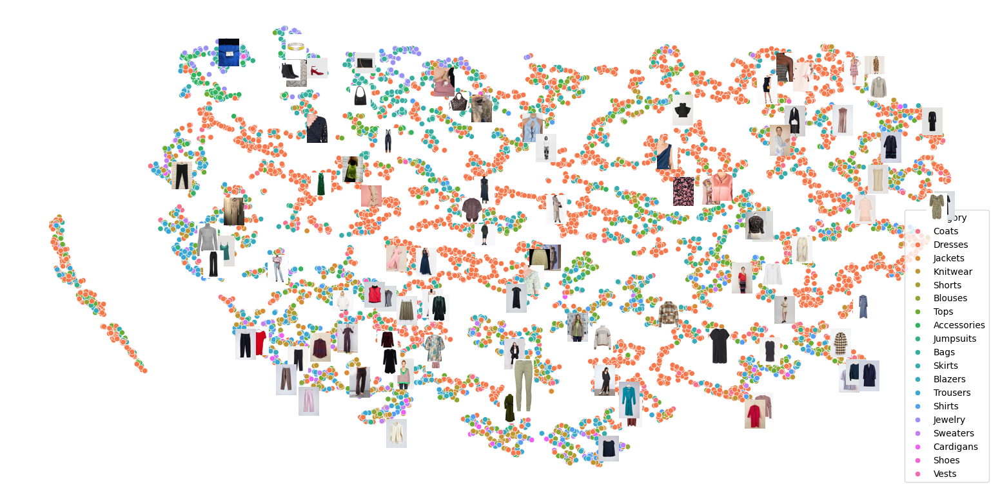

In [30]:
image_with_thumbnails = generate_embedding_tsnes_with_thumbnails.draw_thumbnails_on_scatter_plot(scatter_plot, tsne_df, num_thumbnails=100)
display(image_with_thumbnails)

Cluster 0: 6833
Cluster 1: 1627
Cluster 0:


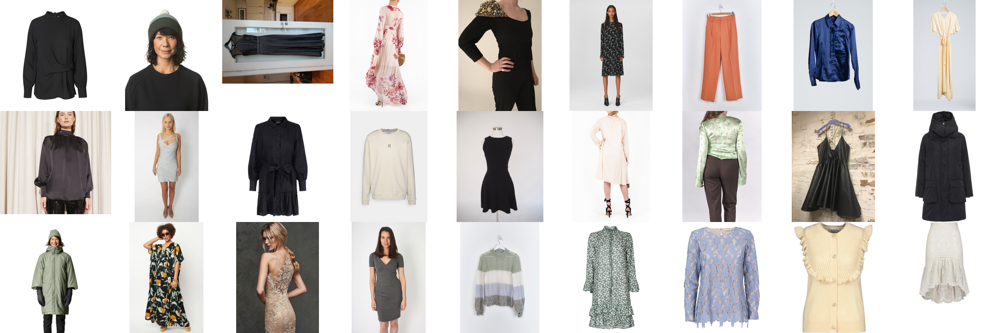

Cluster 1:


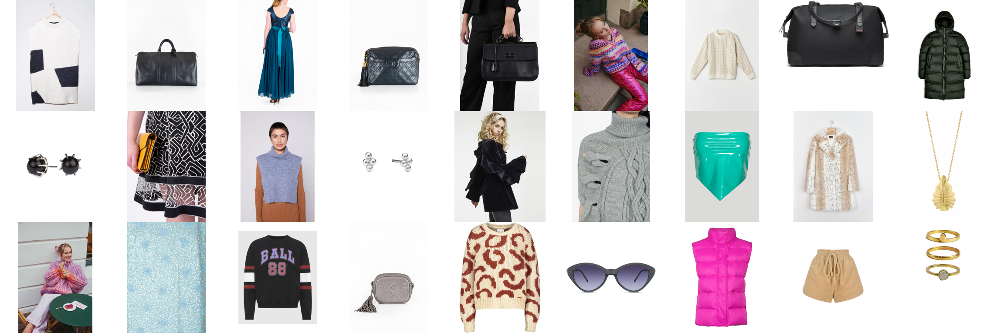

Cluster 0: 1010
Cluster 1: 617
Cluster 0:


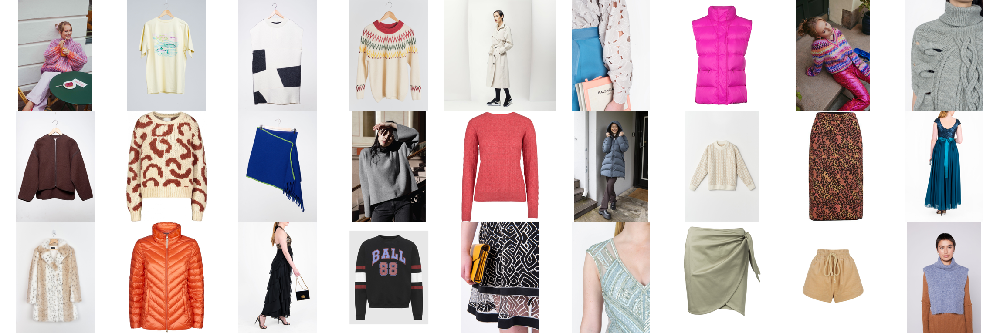

Cluster 1:


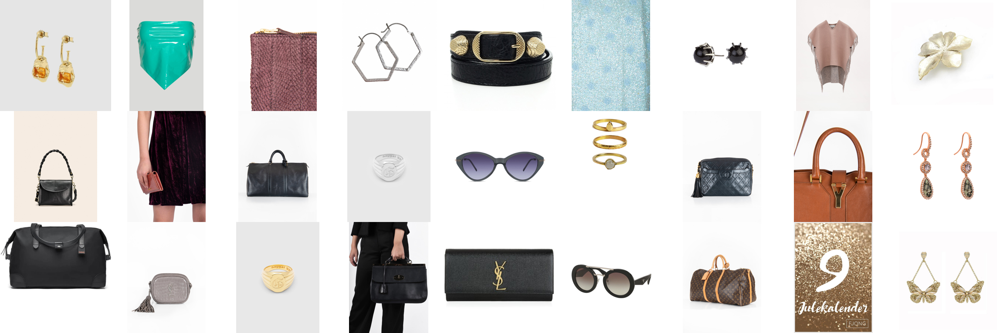

Cluster 0: 310
Cluster 1: 307
Cluster 0:


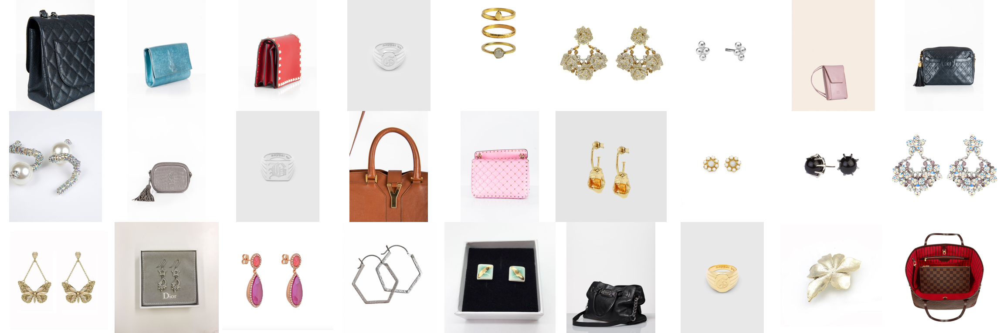

Cluster 1:


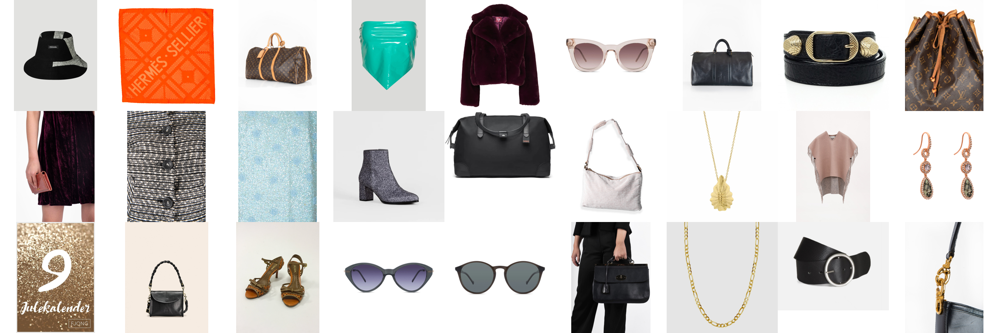

Cluster 0: 198
Cluster 1: 112
Cluster 0:


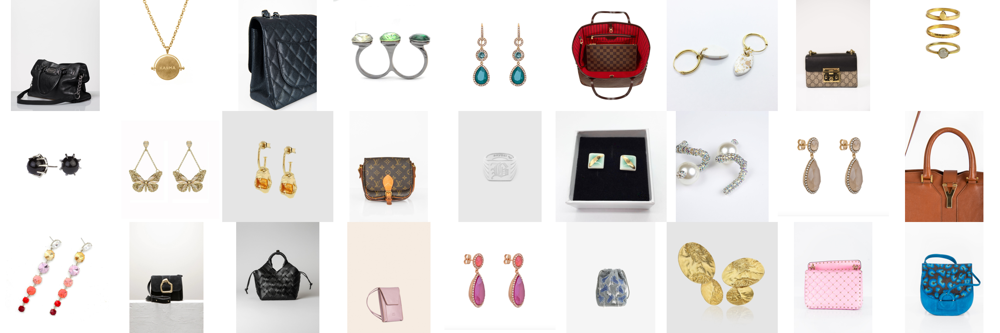

Cluster 1:


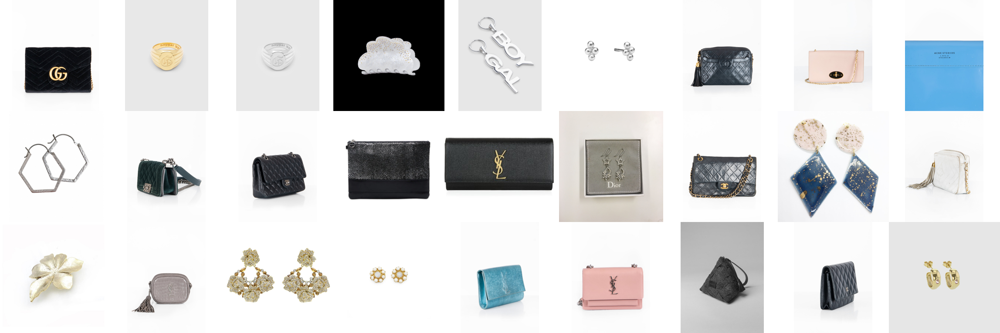

Cluster 0: 33
Cluster 1: 79
Cluster 0:


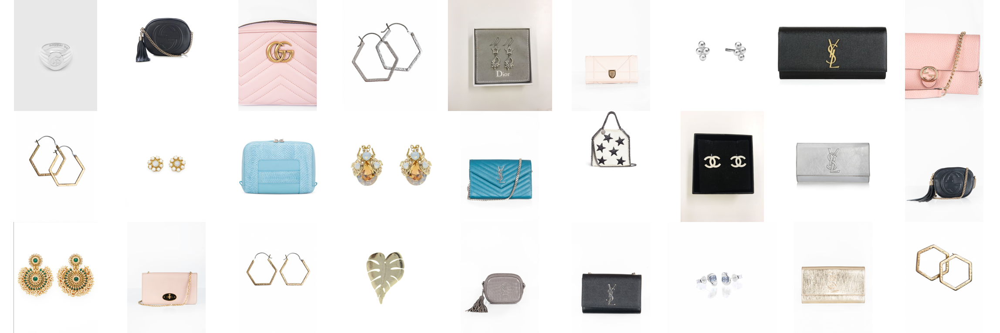

Cluster 1:


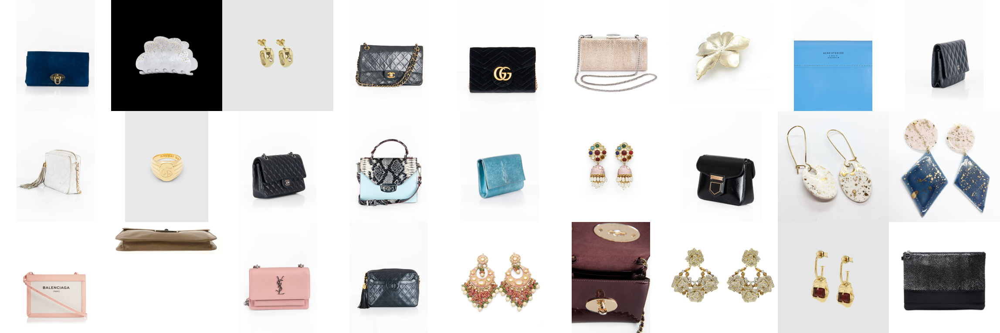

Cluster 0: 53
Cluster 1: 26
Cluster 0:


c:\Users\kaborg15\AppData\Local\anaconda3\envs\style_quiz\Lib\site-packages\sklearn\base.py:1473: ConvergenceWarning: Number of distinct clusters (25) found smaller than n_clusters (26). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


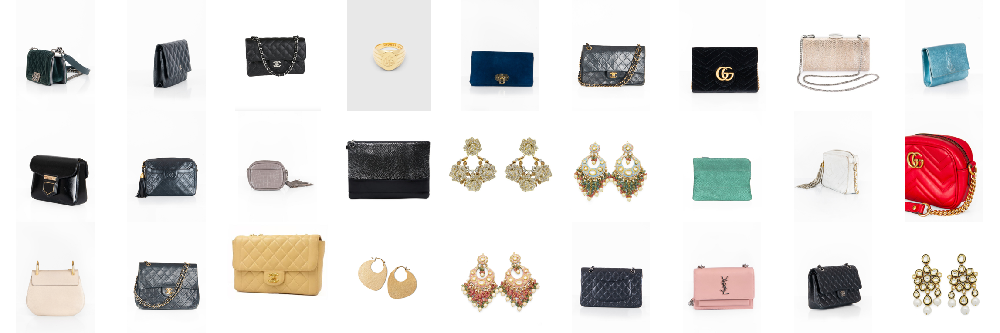

Cluster 1:


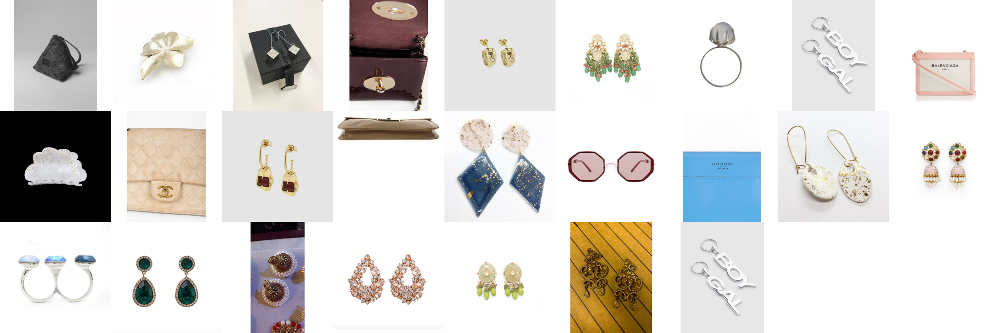

Converged to a single cluster.
Final cluster: 


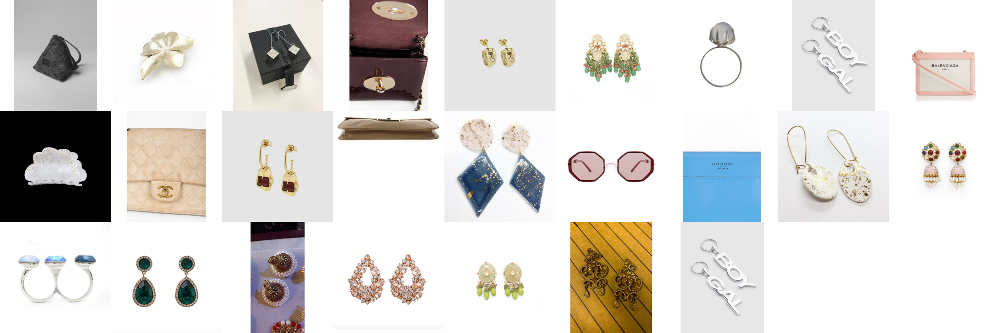

In [53]:
import time
from sklearn.cluster import KMeans
import numpy as np
from src.display_images import display_image_ids

REPRESENTATION_COLUMN = "outfit_embeddings"
NUM_SAMPLES_PER_CLUSTER = 27

outfits_to_lead_picture_id_dict = outfits_df.set_index("id")["lead_picture_id"].to_dict()
current_cluster_df = outfits_df.dropna().copy()
chosen_cluster = ""

while chosen_cluster != "q":
    if len(current_cluster_df) <= NUM_SAMPLES_PER_CLUSTER:
        print("Converged to a single cluster.")
        break

    outfit_representations = np.stack(current_cluster_df[REPRESENTATION_COLUMN].values)
    kmeans = KMeans(n_clusters=2, random_state=0, n_init="auto").fit(outfit_representations)
    current_cluster_df["cluster"] = kmeans.labels_

    cluster_samples = []
    for i in range(2):
        cluster_outfits = current_cluster_df[current_cluster_df["cluster"] == i].copy()
        cluster_embeddings = np.stack(cluster_outfits[REPRESENTATION_COLUMN].values)
        num_cluster_samples = min(NUM_SAMPLES_PER_CLUSTER, len(cluster_outfits))
        cluster_kmeans = KMeans(n_clusters=num_cluster_samples, random_state=1, n_init="auto").fit(cluster_embeddings)
        cluster_outfits["representation_cluster"] = cluster_kmeans.labels_
        cluster_representation = cluster_outfits.groupby("representation_cluster").first().reset_index()
        cluster_samples.append(cluster_representation)
        print(f"Cluster {i}: {len(cluster_outfits)}")

    for i, cluster in enumerate(cluster_samples):
        print(f"Cluster {i}:")
        image_ids = [outfits_to_lead_picture_id_dict[outfit_id] for outfit_id in cluster["id"].values]
        cluster_collage = display_image_ids(image_ids)
        display(cluster_collage)

    time.sleep(1)
    chosen_cluster = ""
    while chosen_cluster not in ["0", "1", "q"]:
        chosen_cluster = input("Choose cluster: ")

    if chosen_cluster == "q":
        break
    
    chosen_cluster = int(chosen_cluster)
    current_cluster_df = current_cluster_df[current_cluster_df["cluster"] == chosen_cluster].copy()

print("Final cluster: ")
display(cluster_collage)

In [55]:
import streamlit as st
import time
from sklearn.cluster import KMeans
import numpy as np
import pandas as pd

# Assuming outfits_df and outfits_to_lead_picture_id_dict are already defined
# outfits_df = pd.read_csv('your_outfits_data.csv')  # Example for loading data
# outfits_to_lead_picture_id_dict = ...  # Example for loading picture IDs

REPRESENTATION_COLUMN = "outfit_embeddings"
NUM_SAMPLES_PER_CLUSTER = 27

current_cluster_df = outfits_df.dropna().copy()
chosen_cluster = None

while chosen_cluster != "q":
    if len(current_cluster_df) <= NUM_SAMPLES_PER_CLUSTER:
        st.write("Converged to a single cluster.")
        break

    outfit_representations = np.stack(current_cluster_df[REPRESENTATION_COLUMN].values)
    kmeans = KMeans(n_clusters=2, random_state=0, n_init="auto").fit(outfit_representations)
    current_cluster_df["cluster"] = kmeans.labels_

    cluster_samples = []
    for i in range(2):
        cluster_outfits = current_cluster_df[current_cluster_df["cluster"] == i].copy()
        cluster_embeddings = np.stack(cluster_outfits[REPRESENTATION_COLUMN].values)
        num_cluster_samples = min(NUM_SAMPLES_PER_CLUSTER, len(cluster_outfits))
        cluster_kmeans = KMeans(n_clusters=num_cluster_samples, random_state=1, n_init="auto").fit(cluster_embeddings)
        cluster_outfits["representation_cluster"] = cluster_kmeans.labels_
        cluster_representation = cluster_outfits.groupby("representation_cluster").first().reset_index()
        cluster_samples.append(cluster_representation)
        st.write(f"Cluster {i}: {len(cluster_outfits)}")

    cluster_collages = []
    for i, cluster in enumerate(cluster_samples):
        st.write(f"Cluster {i}:")
        image_ids = [outfits_to_lead_picture_id_dict[outfit_id] for outfit_id in cluster["id"].values]
        cluster_collage = display_image_ids(image_ids)  # This function should return an image collage
        st.image(cluster_collage, caption=f"Cluster {i} Collage")
        cluster_collages.append(cluster_collage)

    chosen_cluster = st.radio("Choose cluster:", ["0", "1", "Quit"])

    if chosen_cluster == "Quit":
        chosen_cluster = "q"
        break
    
    chosen_cluster = int(chosen_cluster)
    current_cluster_df = current_cluster_df[current_cluster_df["cluster"] == chosen_cluster].copy()
    time.sleep(1)

st.write("Final cluster:")
st.image(cluster_collages[int(chosen_cluster)], caption="Final Cluster Collage")


2024-06-26 10:45:00.784 
  command:

    streamlit run c:\Users\kaborg15\AppData\Local\anaconda3\envs\style_quiz\Lib\site-packages\ipykernel_launcher.py [ARGUMENTS]
2024-06-26 10:45:01.930 Session state does not function when running a script without `streamlit run`
